In [4]:
import pandas as pd
import numpy as np
import sklearn
import nltk
import scipy
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [5]:
import langdetect as ld
import re
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk import word_tokenize, FreqDist
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import random
from sklearn.model_selection import train_test_split
from sklearn import svm
import sklearn.metrics as m
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import GridSearchCV
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.pipeline import Pipeline
import numpy as np
from sklearn.utils import resample
from plotnine import *

In [6]:
from bertopic import BERTopic

In [7]:
biometric = pd.read_excel(r"C:\Users\sahil\OneDrive\Desktop\pythontry\biometric.xlsx")        #loading data

In [8]:
biometric

,Publication Number,Title (English),Abstract,First Claim,Assignee/Applicant,Inventor,Priority Date - Earliest,Publication Date,INPADOC Family Members,IPC Current Full,...,Title - DWPI,Abstract (English),Maintenance Status (US),INPADOC Family Members Dead/Alive,Strategic Importance,Probability of Grant,Domain Influence,Combined Patent Impact,Probability of Restoration Post-Lapse,Probability of Early Lapse
0,AU2022203027A1,Implementation of biometric authentication,The present disclosure relates generally to im...,"1. A method, comprising: at an electronic devi...",Apple Inc.,"Os, Marcel Van | Abbasian, Reza | Anton, Peter...",2022-05-05,2022-05-26,NaN,G06F002132 | G06K000900,...,NaN,The present disclosure relates generally to im...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,KR2022061930A,encryption module using finger scan and contro...,The present invention relates to an encryption...,1. An encryption module provided in a device c...,"Park Jin,KR | SIM GYOOCHAN,KR | 박진,KR | 심규찬,KR","Park Jin | SIM, GYOOCHAN | 박진 | 심규찬",2017-07-03,2022-05-13,KR2022061930A | KR2019004019A,G06F002132 | G05B002302 | G06F002145 | G06F002...,...,NaN,The present invention relates to an encryption...,NaN,KR2022061930A Indeterminate|KR2019004019A Inde...,1.0,57.09,1.0,1.0,NaN,NaN
2,CN114511427A,NaN,本申请公开了一种项目工地的安全教育监管方法、装置及系统，通过服务器获取安全教育终端发送的身份...,1.一种项目工地的安全教育监管方法，其特征在于，应用于服务器，所述方法包括：\n获取安全教育...,"四川省大数据中心,成都市,四川省,610000,CN",顾红松 | 赵启斌 | 唐为之 | 王思航 | 覃子凌,2022-04-21,2022-05-17,CN114511427A,G06Q005020 | G06F00162455 | G06F002132 | G06F0...,...,NaN,NaN,NaN,CN114511427A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN
3,CN114510703A,NaN,本发明涉及物联网技术领域，具体的公开了一种物联网设备的身份标识认证方法及通信系统，所述的物联...,1.一种物联网设备的身份标识通信系统，其特征在于，所述的物联网设备的身份标识通信系统包括语音...,"尚班(北京)网络科技有限公司,北京市,北京市,100000,CN",李光顺,2022-04-20,2022-05-17,CN114510703A,G06F002144 | G06F002132 | G06F002145 | G16Y004050,...,NaN,NaN,NaN,CN114510703A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN
4,CN114511917A,NaN,本发明实施例提供了一种图像数据的处理方法及装置、电子设备、存储介质，方法包括：获取针对目标人...,1.一种图像数据的处理方法，其特征在于，所述方法包括：\n获取针对目标人脸所采集的目标图像数...,"北京美摄网络科技有限公司,北京市,北京市,100195,CN",张瑞全 | 尚盼龙 | 刘铁华 | 李振,2022-04-20,2022-05-17,CN114511917A,G06V004016 | G06F002132,...,NaN,NaN,NaN,CN114511917A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28550,NL2011998C,NaN,NaN,NaN,NaN,NaN,2013-12-20,2015-06-26,NaN,NaN,...,System for performing transaction electronical...,NaN,NaN,NaN,1.0,100.00,1.0,1.0,NaN,0.42
28551,NO201300289A,NaN,NaN,NaN,NaN,NaN,2013-02-22,2014-08-25,NaN,NaN,...,Fingerprint sensor for integration in smart ph...,NaN,NaN,NaN,1.0,0.00,1.0,1.0,NaN,NaN
28552,NO201300886A,NaN,NaN,NaN,NaN,NaN,2013-06-26,2014-06-29,NaN,NaN,...,"Method for authenticating user, involves drawi...",NaN,NaN,NaN,1.0,0.00,1.0,1.0,NaN,NaN
28553,NO201301423A,NaN,NaN,NaN,NaN,NaN,2013-02-22,2014-08-25,NaN,NaN,...,Fingerprint sensor for integration in smart ph...,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN,NaN


In [9]:
biometric.describe()

,Count of Cited Refs - Patent,Count of Cited Refs - Non-patent,Count of Citing Patents,Strategic Importance,Probability of Grant,Domain Influence,Combined Patent Impact,Probability of Restoration Post-Lapse,Probability of Early Lapse
count,28555.000000,28555.000000,28555.000000,28221.000000,22246.000000,28221.000000,28221.000000,69.000000,9222.000000
mean,6.038137,0.942042,1.404448,1.509830,66.812376,3.623173,3.223587,18.293333,27.942469
std,27.700650,10.508773,5.984700,2.156655,35.035114,6.251872,5.185330,13.533425,24.663635
min,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.120000,0.000000
25%,0.000000,0.000000,0.000000,1.000000,36.450000,1.890000,1.710000,7.610000,7.362500
50%,3.000000,0.000000,0.000000,1.000000,70.440000,2.330000,2.070000,16.600000,14.500000
75%,6.000000,0.000000,1.000000,1.000000,100.000000,3.660000,3.140000,26.500000,51.600000
max,1353.000000,802.000000,232.000000,88.640000,100.000000,100.000000,95.710000,64.700000,89.800000


In [10]:
biometric.shape

(28555, 30)

In [11]:
biometric.columns

Index(['Publication Number', 'Title (English)', 'Abstract', 'First Claim',
       'Assignee/Applicant', 'Inventor', 'Priority Date - Earliest',
       'Publication Date', 'INPADOC Family Members', 'IPC Current Full',
       'Independent Claims', 'INPADOC Legal Status', 'Dead/Alive',
       'CPC - Current', 'Claims Count', 'Count of Cited Refs - Patent',
       'Count of Cited Refs - Non-patent', 'Count of Citing Patents',
       'Priority Country/Region', 'Application Date', 'Title - DWPI',
       'Abstract (English)', 'Maintenance Status (US)',
       'INPADOC Family Members Dead/Alive', 'Strategic Importance',
       'Probability of Grant', 'Domain Influence', 'Combined Patent Impact',
       'Probability of Restoration Post-Lapse', 'Probability of Early Lapse'],
      dtype='object')

In [12]:
biometric.isnull().sum()

Publication Number                           0
Title (English)                            848
Abstract                                  2096
First Claim                               1878
Assignee/Applicant                         724
Inventor                                  1453
Priority Date - Earliest                     0
Publication Date                             0
INPADOC Family Members                    3192
IPC Current Full                          1129
Independent Claims                        2158
INPADOC Legal Status                      4854
Dead/Alive                                   0
CPC - Current                             8512
Claims Count                              1962
Count of Cited Refs - Patent                 0
Count of Cited Refs - Non-patent             0
Count of Citing Patents                      0
Priority Country/Region                    379
Application Date                             0
Title - DWPI                              1251
Abstract (Eng

In [19]:
# Removing Nan / nan values from Dataset
docs = list(biometric.loc[:, "Title (English)"].values)
biometric["Title (English)"].fillna('NO DATA', inplace=True)

In [20]:
biometric

,Publication Number,Title (English),Abstract,First Claim,Assignee/Applicant,Inventor,Priority Date - Earliest,Publication Date,INPADOC Family Members,IPC Current Full,...,Abstract (English),Maintenance Status (US),INPADOC Family Members Dead/Alive,Strategic Importance,Probability of Grant,Domain Influence,Combined Patent Impact,Probability of Restoration Post-Lapse,Probability of Early Lapse,clean_text
0,AU2022203027A1,Implementation of biometric authentication,The present disclosure relates generally to im...,"1. A method, comprising: at an electronic devi...",Apple Inc.,"Os, Marcel Van | Abbasian, Reza | Anton, Peter...",2022-05-05,2022-05-26,NaN,G06F002132 | G06K000900,...,The present disclosure relates generally to im...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,method comprising electronic device display b...
1,KR2022061930A,encryption module using finger scan and contro...,The present invention relates to an encryption...,1. An encryption module provided in a device c...,"Park Jin,KR | SIM GYOOCHAN,KR | 박진,KR | 심규찬,KR","Park Jin | SIM, GYOOCHAN | 박진 | 심규찬",2017-07-03,2022-05-13,KR2022061930A | KR2019004019A,G06F002132 | G05B002302 | G06F002145 | G06F002...,...,The present invention relates to an encryption...,NaN,KR2022061930A Indeterminate|KR2019004019A Inde...,1.0,57.09,1.0,1.0,NaN,NaN,encryption module provided device capable app...
2,CN114511427A,NO DATA,本申请公开了一种项目工地的安全教育监管方法、装置及系统，通过服务器获取安全教育终端发送的身份...,1.一种项目工地的安全教育监管方法，其特征在于，应用于服务器，所述方法包括：\n获取安全教育...,"四川省大数据中心,成都市,四川省,610000,CN",顾红松 | 赵启斌 | 唐为之 | 王思航 | 覃子凌,2022-04-21,2022-05-17,CN114511427A,G06Q005020 | G06F00162455 | G06F002132 | G06F0...,...,NaN,NaN,CN114511427A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN,一种项目工地的安全教育监管方法，其特征在于，应用于服务器，所述方法包括： 获取安全教育终端...
3,CN114510703A,NO DATA,本发明涉及物联网技术领域，具体的公开了一种物联网设备的身份标识认证方法及通信系统，所述的物联...,1.一种物联网设备的身份标识通信系统，其特征在于，所述的物联网设备的身份标识通信系统包括语音...,"尚班(北京)网络科技有限公司,北京市,北京市,100000,CN",李光顺,2022-04-20,2022-05-17,CN114510703A,G06F002144 | G06F002132 | G06F002145 | G16Y004050,...,NaN,NaN,CN114510703A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN,一种物联网设备的身份标识通信系统，其特征在于，所述的物联网设备的身份标识通信系统包括语音获...
4,CN114511917A,NO DATA,本发明实施例提供了一种图像数据的处理方法及装置、电子设备、存储介质，方法包括：获取针对目标人...,1.一种图像数据的处理方法，其特征在于，所述方法包括：\n获取针对目标人脸所采集的目标图像数...,"北京美摄网络科技有限公司,北京市,北京市,100195,CN",张瑞全 | 尚盼龙 | 刘铁华 | 李振,2022-04-20,2022-05-17,CN114511917A,G06V004016 | G06F002132,...,NaN,NaN,CN114511917A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN,一种图像数据的处理方法，其特征在于，所述方法包括： 获取针对目标人脸所采集的目标图像数据；...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28550,NL2011998C,NO DATA,NaN,NaN,NaN,NaN,2013-12-20,2015-06-26,NaN,NaN,...,NaN,NaN,NaN,1.0,100.00,1.0,1.0,NaN,0.42,nan
28551,NO201300289A,NO DATA,NaN,NaN,NaN,NaN,2013-02-22,2014-08-25,NaN,NaN,...,NaN,NaN,NaN,1.0,0.00,1.0,1.0,NaN,NaN,nan
28552,NO201300886A,NO DATA,NaN,NaN,NaN,NaN,2013-06-26,2014-06-29,NaN,NaN,...,NaN,NaN,NaN,1.0,0.00,1.0,1.0,NaN,NaN,nan
28553,NO201301423A,NO DATA,NaN,NaN,NaN,NaN,2013-02-22,2014-08-25,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN,NaN,nan


In [21]:
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

stop_words = stopwords.words('english')

def clean_text(x):
  x = str(x)
  x = x.lower()
  x = re.sub(r'#[A-Za-z0-9]*', ' ', x)
  x = re.sub(r'https*://.*', ' ', x)
  x = re.sub(r'@[A-Za-z0-9]+', ' ', x)
  tokens = word_tokenize(x)
  x = ' '.join([w for w in tokens if not w.lower() in stop_words])
  x = re.sub(r'[%s]' % re.escape('!"#$%&\()*+,-./:;<=>?@[\\]^_`{|}~“…”’'), ' ', x)
  x = re.sub(r'\d+', ' ', x)
  x = re.sub(r'\n+', ' ', x)
  x = re.sub(r'\s{2,}', ' ', x)
  return x


biometric['clean_text'] = biometric['First Claim'].apply(clean_text)
biometric.head()

,Publication Number,Title (English),Abstract,First Claim,Assignee/Applicant,Inventor,Priority Date - Earliest,Publication Date,INPADOC Family Members,IPC Current Full,...,Abstract (English),Maintenance Status (US),INPADOC Family Members Dead/Alive,Strategic Importance,Probability of Grant,Domain Influence,Combined Patent Impact,Probability of Restoration Post-Lapse,Probability of Early Lapse,clean_text
0,AU2022203027A1,Implementation of biometric authentication,The present disclosure relates generally to im...,"1. A method, comprising: at an electronic devi...",Apple Inc.,"Os, Marcel Van | Abbasian, Reza | Anton, Peter...",2022-05-05,2022-05-26,NaN,G06F002132 | G06K000900,...,The present disclosure relates generally to im...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,method comprising electronic device display b...
1,KR2022061930A,encryption module using finger scan and contro...,The present invention relates to an encryption...,1. An encryption module provided in a device c...,"Park Jin,KR | SIM GYOOCHAN,KR | 박진,KR | 심규찬,KR","Park Jin | SIM, GYOOCHAN | 박진 | 심규찬",2017-07-03,2022-05-13,KR2022061930A | KR2019004019A,G06F002132 | G05B002302 | G06F002145 | G06F002...,...,The present invention relates to an encryption...,NaN,KR2022061930A Indeterminate|KR2019004019A Inde...,1.0,57.09,1.0,1.0,NaN,NaN,encryption module provided device capable app...
2,CN114511427A,NO DATA,本申请公开了一种项目工地的安全教育监管方法、装置及系统，通过服务器获取安全教育终端发送的身份...,1.一种项目工地的安全教育监管方法，其特征在于，应用于服务器，所述方法包括：\n获取安全教育...,"四川省大数据中心,成都市,四川省,610000,CN",顾红松 | 赵启斌 | 唐为之 | 王思航 | 覃子凌,2022-04-21,2022-05-17,CN114511427A,G06Q005020 | G06F00162455 | G06F002132 | G06F0...,...,NaN,NaN,CN114511427A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN,一种项目工地的安全教育监管方法，其特征在于，应用于服务器，所述方法包括： 获取安全教育终端...
3,CN114510703A,NO DATA,本发明涉及物联网技术领域，具体的公开了一种物联网设备的身份标识认证方法及通信系统，所述的物联...,1.一种物联网设备的身份标识通信系统，其特征在于，所述的物联网设备的身份标识通信系统包括语音...,"尚班(北京)网络科技有限公司,北京市,北京市,100000,CN",李光顺,2022-04-20,2022-05-17,CN114510703A,G06F002144 | G06F002132 | G06F002145 | G16Y004050,...,NaN,NaN,CN114510703A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN,一种物联网设备的身份标识通信系统，其特征在于，所述的物联网设备的身份标识通信系统包括语音获...
4,CN114511917A,NO DATA,本发明实施例提供了一种图像数据的处理方法及装置、电子设备、存储介质，方法包括：获取针对目标人...,1.一种图像数据的处理方法，其特征在于，所述方法包括：\n获取针对目标人脸所采集的目标图像数...,"北京美摄网络科技有限公司,北京市,北京市,100195,CN",张瑞全 | 尚盼龙 | 刘铁华 | 李振,2022-04-20,2022-05-17,CN114511917A,G06V004016 | G06F002132,...,NaN,NaN,CN114511917A Indeterminate,NaN,NaN,NaN,NaN,NaN,NaN,一种图像数据的处理方法，其特征在于，所述方法包括： 获取针对目标人脸所采集的目标图像数据；...


In [22]:
combi = biometric.append(biometric, ignore_index=True)
combi.shape

(57110, 31)

In [23]:
# Creating Topics
model = BERTopic(language="english")
topics, probs = model.fit_transform(docs)

In [24]:
# Count Of topics
freq = model.get_topic_info()
print("Number of topics: {}".format( len(freq)))
freq.head()

Number of topics: 487


,Topic,Count,Name
0,-1,8696,-1_face_access_management_biometric
1,0,855,0_no_data_verified_omitted
2,1,370,1_fingerprint_terminal_mobile_identification
3,2,334,2_iris_recognition_irisbased_recognizing
4,3,212,3_biological_characteristic_feature_biological...


Above table has 3 main columns which includes information about all the 465 topics in descending order of topics Count.

In [25]:
model.get_topic_freq().head()


,Topic,Count
0,-1,8696
1,0,855
2,1,370
3,2,334
4,3,212


In [26]:
model.get_topic(49)[:10]


[('fingerprint', 0.019033753810566167),
 ('electronic', 0.016654933596296086),
 ('recognizing', 0.015662043491238262),
 ('circuit', 0.012458468117969357),
 ('detecting', 0.01229620312601419),
 ('assembly', 0.010746108227533024),
 ('drag', 0.00974331199192471),
 ('documentor', 0.00974331199192471),
 ('originals', 0.00974331199192471),
 ('identification', 0.009419504742697926)]

In [27]:
model.get_topic_info()

,Topic,Count,Name
0,-1,8696,-1_face_access_management_biometric
1,0,855,0_no_data_verified_omitted
2,1,370,1_fingerprint_terminal_mobile_identification
3,2,334,2_iris_recognition_irisbased_recognizing
4,3,212,3_biological_characteristic_feature_biological...
...,...,...,...
482,481,10,481_financial_calculation_machine_service
483,482,10,482_biological_measures_granting_early
484,483,10,483_users_authenticating_airblow_regarding
485,484,10,484_metal_sleeve_protective_recognizer


In [28]:
# Words for the first topic
topic_one = freq.iloc[0]["Topic"] 
model.get_topic(topic_one) # Show the words and their c-TF-IDF scores

[('face', 0.002325021552177429),
 ('access', 0.0023089890438906563),
 ('management', 0.002236970695283228),
 ('biometric', 0.0022292622138849845),
 ('to', 0.0022175611178084326),
 ('for', 0.0022075596093947473),
 ('system', 0.0021319206624910336),
 ('on', 0.0021270482620007985),
 ('based', 0.0021207124151201235),
 ('of', 0.002090661920155392)]

In [29]:
model.visualize_topics()

In [30]:
# Topics can be visualized in the form of barchart out of the c-TF-IDF score
# (TF-IDF (term frequency-inverse document frequency) is a statistical measure that 
#  evaluates how relevant a word is to a document in a collection of documents)


In [33]:
model.visualize_heatmap()

In [34]:
# REDUCING THE TOPICS => by passing argument nr_topics with a number of topics you want
new_topics, new_probs = model.reduce_topics(docs, topics,
probs, nr_topics=30)

In [35]:
docs

['Implementation of biometric authentication',
 'encryption module using finger scan and control process the same',
 'NO DATA',
 'NO DATA',
 'NO DATA',
 'Identity authentication method and device',
 'Software authorization method and software authorization system based on block chain',
 'intelligent training system based on private cloud technology',
 'Human-computer interaction method, device, device and storage medium',
 'APP fingerprint login method based on artificial intelligence and related device',
 'E-AUTHENTICATION SYSTEM USING EYE BLINKING AND DEEP LEARNING.',
 'A LOCKING UNIT AND A METHOD TO OPERATE A DEVICE',
 'Identity authentication method, device, electronic device and medium',
 'RECOMMENDED METHOD, DEVICE AND EQUIPMENT FOR LOGGING IN AFTER UNINSTALLING AND REINSTALLING AN APPLICATION',
 'AUTHENTICATOR APP FOR CONSENT ARCHITECTURE',
 'User authority management method and system',
 'AI screening identity recognition',
 'SMART WEARABLE DEVICE',
 'The control method of a se

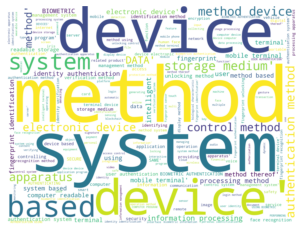

In [36]:
# Create stopword list :


stop_words = set(STOPWORDS)
stop_words.update(['ourselves', 'hers', 'between', 'yourself', 'but', 'again', 'there', 'about', 'once', 'during', 'out', 
                   'very', 'having', 'with', 'they', 'own', 'an', 'be', 'some', 'for', 'do', 'its', 'yours', 'such', 'into', 
                   'of', 'most', 'itself', 'other', 'off', 'is', 's', 'am', 'or', 'who', 'as', 'from', 'him', 'each', 'the', 
                   'themselves', 'until', 'below', 'are', 'we', 'these', 'your', 'his', 'through', 'don', 'nor', 'me', 'were',
                   'her', 'more', 'himself', 'this', 'down', 'should', 'our', 'their', 'while', 'above', 'both', 'up', 'to', 
                   'ours', 'had', 'she', 'all', 'no', 'when', 'at', 'any', 'before', 'them', 'same', 'and', 'been', 'have', 
                   'in','will', 'on', 'does', 'yourselves', 'then', 'that', 'because', 'what', 'over', 'why', 'so',
                   'can', 'did', 'not','now', 'under', 'he', 'you', 'herself', 'has', 'just', 'where', 'too', 'only', 
                   'myself', 'which', 'those', 'i','after', 'few', 'whom', 't', 'being', 'if', 'theirs', 'my', 
                   'against', 'a', 'by', 'doing', 'it', 'how', 'further', 'was', 'here', 'than'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stop_words, background_color="white", width=2000, height=1500).generate(str(docs))

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [37]:
model.visualize_topics(top_n_topics=30)

In [38]:
# Topics can be visualized in the form of barchart out of the c-TF-IDF score
# (TF-IDF (term frequency-inverse document frequency) is a statistical measure that 
#  evaluates how relevant a word is to a document in a collection of documents)
model.visualize_barchart(top_n_topics=10)

In [39]:
# We can visualize how similar certain topics are to each other
model.visualize_heatmap()

In [40]:
# Topics with the same colors have been grouped together which are similar one to another.
model.visualize_hierarchy(top_n_topics=20)

In [41]:
# Similar_topics contains the topics index from most similar to least similar.
# similarity contains the similarity scores in descending order.
similar_topic = input('Enter the name of word that you want to seach in topics => ')
similar_topics, similarity = model.find_topics(similar_topic, top_n = 3)
most_similar = similar_topics[0]
print("Most Similar Topic Info=\n {}".format(model.get_topic(most_similar)))
print("Similarity Score=> {}".format(similarity[0]))
print(similar_topics)   

Enter the name of word that you want to seach in topics => eye
Most Similar Topic Info=
 [('eye', 0.10358731912455506), ('gaze', 0.05157348414122114), ('tracking', 0.03500238268619679), ('pupil', 0.03451690696552481), ('eyeball', 0.03137900633229529), ('movement', 0.02646420129327364), ('ocular', 0.01774499725361936), ('myopia', 0.016565715372948257), ('vision', 0.014325967817005875), ('detailed', 0.013165454088432886)]
Similarity Score=> 0.9267841817006135
[20, 293, 22]


In [42]:
docs

['Implementation of biometric authentication',
 'encryption module using finger scan and control process the same',
 'NO DATA',
 'NO DATA',
 'NO DATA',
 'Identity authentication method and device',
 'Software authorization method and software authorization system based on block chain',
 'intelligent training system based on private cloud technology',
 'Human-computer interaction method, device, device and storage medium',
 'APP fingerprint login method based on artificial intelligence and related device',
 'E-AUTHENTICATION SYSTEM USING EYE BLINKING AND DEEP LEARNING.',
 'A LOCKING UNIT AND A METHOD TO OPERATE A DEVICE',
 'Identity authentication method, device, electronic device and medium',
 'RECOMMENDED METHOD, DEVICE AND EQUIPMENT FOR LOGGING IN AFTER UNINSTALLING AND REINSTALLING AN APPLICATION',
 'AUTHENTICATOR APP FOR CONSENT ARCHITECTURE',
 'User authority management method and system',
 'AI screening identity recognition',
 'SMART WEARABLE DEVICE',
 'The control method of a se

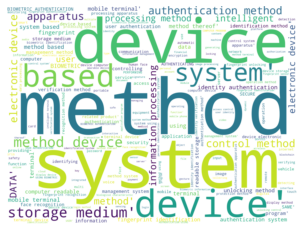

In [43]:
# Create stopword list :
stop_words = set(STOPWORDS)
stop_words.update(['ourselves', 'hers', 'between', 'yourself', 'but', 'again', 'there', 'about', 'once', 'during', 'out', 
                   'very', 'having', 'with', 'they', 'own', 'an', 'be', 'some', 'for', 'do', 'its', 'yours', 'such', 'into', 
                   'of', 'most', 'itself', 'other', 'off', 'is', 's', 'am', 'or', 'who', 'as', 'from', 'him', 'each', 'the', 
                   'themselves', 'until', 'below', 'are', 'we', 'these', 'your', 'his', 'through', 'don', 'nor', 'me', 'were',
                   'her', 'more', 'himself', 'this', 'down', 'should', 'our', 'their', 'while', 'above', 'both', 'up', 'to', 
                   'ours', 'had', 'she', 'all', 'no', 'when', 'at', 'any', 'before', 'them', 'same', 'and', 'been', 'have', 
                   'in','will', 'on', 'does', 'yourselves', 'then', 'that', 'because', 'what', 'over', 'why', 'so',
                   'can', 'did', 'not','now', 'under', 'he', 'you', 'herself', 'has', 'just', 'where', 'too', 'only', 
                   'myself', 'which', 'those', 'i','after', 'few', 'whom', 't', 'being', 'if', 'theirs', 'my', 
                   'against', 'a', 'by', 'doing', 'it', 'how', 'further', 'was', 'here', 'than'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stop_words, background_color="white", width=2000, height=1500).generate(str(docs))

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [45]:
# Stemming and Lemmatization
from nltk.stem.porter import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

porter = PorterStemmer()
wordnet = WordNetLemmatizer()

preprocessed_docs = []

for doc in stop_words:
    final_doc = []
    for word in doc:
        final_doc.append(porter.stem(word))
        final_doc.append(wordnet.lemmatize(word))
    
    preprocessed_docs.append(final_doc)

print(preprocessed_docs)

[['w', 'w', 'h', 'h', 'y', 'y'], ['t', 't', 'h', 'h', 'a', 'a', 't', 't'], ['o', 'o', 'n', 'n'], ['h', 'h', 'o', 'o', 'w', 'w'], ['s', 's', 'h', 'h', 'e', 'e', "'", "'", 's', 's'], ['t', 't', 'h', 'h', 'e', 'e', 'i', 'i', 'r', 'r', 's', 's'], ['w', 'w', 'h', 'h', 'o', 'o', 'm', 'm'], ['i', 'i', 't', 't', 's', 's', 'e', 'e', 'l', 'l', 'f', 'f'], ['a', 'a', 'r', 'r', 'e', 'e', 'n', 'n', "'", "'", 't', 't'], ['o', 'o', 'u', 'u', 'g', 'g', 'h', 'h', 't', 't'], ['w', 'w', 'h', 'h', 'a', 'a', 't', 't'], ['d', 'd', 'i', 'i', 'd', 'd', 'n', 'n', "'", "'", 't', 't'], ['y', 'y', 'o', 'o', 'u', 'u', 'r', 'r'], ['w', 'w', 'a', 'a', 's', 's', 'n', 'n', "'", "'", 't', 't'], ['y', 'y', 'o', 'o', 'u', 'u'], ['o', 'o', 'n', 'n', 'l', 'l', 'y', 'y'], ['i', 'i', "'", "'", 'l', 'l', 'l', 'l'], ['b', 'b', 'y', 'y'], ['a', 'a', 'b', 'b', 'o', 'o', 'u', 'u', 't', 't'], ['t', 't', 'h', 'h', 'e', 'e', 'n', 'n'], ['h', 'h', 'o', 'o', 'w', 'w', "'", "'", 's', 's'], ['o', 'o', 'u', 'u', 'r', 'r'], ['o', 'o', 'f',